# Utilities

In [1]:
from sympy import factorint

In [2]:
import itertools
import json
import time
import os

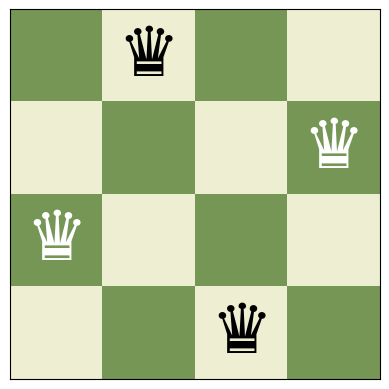

In [3]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap

def plot_chess_board(matrix, fontsize=50):
    n = matrix.shape[0]
    # Create a chess board (n x n) pattern
    board = np.zeros_like(matrix)
    board[1::2, ::2] = 1
    board[::2, 1::2] = 1
    
    cmap = ListedColormap(['#769656', '#eeeed2'])
    fig, ax = plt.subplots()
    ax.imshow(board, cmap=cmap, interpolation='nearest')
    
    # Place queens based on matrix
    for i in range(n):
        for j in range(n):
            if matrix[i, j] == 1:
                ax.text(j, i, '♛', fontsize=fontsize, ha='center', va='center', color='black' if board[i, j] else 'white')
    
    # Hide the axes
    ax.set_xticks([])
    ax.set_yticks([])

# Example binary matrix
matrix = np.array([[0, 1, 0, 0],
                   [0, 0, 0, 1],
                   [1, 0, 0, 0],
                   [0, 0, 1, 0]])

plot_chess_board(matrix)

In [4]:
factorial = lambda n: 1 if n <= 1 else n*factorial(n-1)
factorial(5)

120

In [5]:
# 0 <= num <= N! - 1
def decimal2factoradic(N, num):
    factoradic = []
    for i in range(1,N+1):
        factoradic.append(num%i)
        num //= i
    return list(reversed(factoradic))

decimal2factoradic(4, 4)

[0, 2, 0, 0]

In [6]:
def factoradic2permutation(factoriadic):
    N = len(factoriadic)
    elements = list(range(1,N+1))
    
    permutation = []
    for idx in factoriadic:
        permutation.append(elements.pop(idx))
        
    return permutation

factoradic2permutation([0,2,0,0])

[1, 4, 2, 3]

In [7]:
# Can be sped up to N*ln(N)
def permutation2factoradic(permutation):
    factoriadic = []
    N = len(permutation)
    for i in range(N):
        lt_i = 0
        for j in range(i+1,N):
            lt_i += int(permutation[j] < permutation[i])
        factoriadic.append(lt_i)
    
    return factoriadic

permutation2factoradic([1,4,2,3])

[0, 2, 0, 0]

In [8]:
def factoradic2decimal(factoriadic):
    N = len(factoriadic)
    dec = 0
    for i in reversed(range(N)):
        dec += factoriadic[i] * factorial(N-1-i)
        
    return dec

factoradic2decimal([0,2,0,0])

4

In [9]:
def board2permutation(board):
    N = len(board)
    perm = []
    for i in range(N):
        for j in range(N):
            if board[i][j]: perm.append(j+1)
                
    return perm

board2permutation([[0,1,0,0],
                   [0,0,0,1],
                   [1,0,0,0],
                   [0,0,1,0]])

[2, 4, 1, 3]

In [10]:
def permutation2board(perm):
    N = len(perm)
    board = [[0] * N for _ in range(N)]
    
    for i in range(N):
        board[i][perm[i]-1] = 1
        
    return board

permutation2board([2,4,1,3])

[[0, 1, 0, 0], [0, 0, 0, 1], [1, 0, 0, 0], [0, 0, 1, 0]]

In [11]:
class NQueen_sym90:
    def __init__(self, N):
        self.N = N
        self.solutions = set()
        self.board = [[0]*N for _ in range(N)]

    def solve_symmetric_nqueen(self, num_placed=0, row=0, rows=set(), cols=set(), diags=set(), anti_diags=set()):
        if num_placed == self.N:
            return self.solutions.add(factoradic2decimal(permutation2factoradic(board2permutation(self.board))))

        if row in rows:
            return self.solve_symmetric_nqueen(num_placed, row+1, rows, cols, diags, anti_diags)

        for col in range(self.N):
            if col in cols or (col - row) in diags or (col + row) in anti_diags: continue
            overlap = self._add_to_sets(row,col,rows,cols,diags,anti_diags)
            self._add_to_board(row,col)
            
            if not overlap:
                self.solve_symmetric_nqueen(num_placed+4, row+1, rows, cols, diags, anti_diags)

            self._remove_from_board(row,col)
            self._remove_from_sets(row,col,rows,cols,diags,anti_diags)
            
    def _add_to_sets(self, row, col, rows, cols, diags, anti_diags):
        _rows = [row, col, self.N-1-row, self.N-1-col]
        _cols = [col, self.N-1-row, self.N-1-col, row]

        for i,j in zip(_rows,_cols):
            if i in rows or j in cols or j-i in diags or j+i in anti_diags: return True # overlap is true
            rows.add(i)
            cols.add(j)
            diags.add(j-i)
            anti_diags.add(j+i)
        return False # overlap is false

    def _remove_from_sets(self, row, col, rows, cols, diags, anti_diags):
        _rows = [row, col, self.N-1-row, self.N-1-col]
        _cols = [col, self.N-1-row, self.N-1-col, row]
        for i,j in zip(_rows, _cols):
            if i in rows: rows.remove(i)
            if j in cols: cols.remove(j)
            if j-i in diags: diags.remove(j-i)
            if j+i in anti_diags: anti_diags.remove(j+i)

    def _add_to_board(self, row, col):
        _rows = [row, col, self.N-1-row, self.N-1-col]
        _cols = [col, self.N-1-row, self.N-1-col, row]
        for i,j in zip(_rows, _cols):
            self.board[i][j] = 1
            
    def _remove_from_board(self, row, col):
        _rows = [row, col, self.N-1-row, self.N-1-col]
        _cols = [col, self.N-1-row, self.N-1-col, row]
        for i,j in zip(_rows, _cols):
            self.board[i][j] = 0
            

for N in range(1, 28+1):
    print("-"*100)
    print(N)
    solver = NQueen_sym90(N)
    if N%2 == 0:
        solver.solve_symmetric_nqueen()
    else:
        solver.board[N//2][N//2] = 1
        solver.solve_symmetric_nqueen(1,0,set([(N-1)//2]),set([(N-1)//2]),set([0]),set([N-1]))
    result = len(solver.solutions)
        
    print(result)
    factors = factorint(result)
    print([v for row in [[factor]*power for (factor, power) in factors.items()] for v in row])

----------------------------------------------------------------------------------------------------
1
1
[]
----------------------------------------------------------------------------------------------------
2
0
[0]
----------------------------------------------------------------------------------------------------
3
0
[0]
----------------------------------------------------------------------------------------------------
4
2
[2]
----------------------------------------------------------------------------------------------------
5
2
[2]
----------------------------------------------------------------------------------------------------
6
0
[0]
----------------------------------------------------------------------------------------------------
7
0
[0]
----------------------------------------------------------------------------------------------------
8
0
[0]
----------------------------------------------------------------------------------------------------
9
0
[0]
--------------------

# Distance measure
I normalize to $[-\frac{1}{2}, \frac{1}{2}]^{2}$ and then define the distance measure:
\begin{align}
    d(\gamma_1, \gamma_2) = \int_{-\frac{1}{2}}^{\frac{1}{2}}\int_{-\frac{1}{2}}^{\frac{1}{2}}|\gamma_1(x,y) - \gamma_2(x,y)|dxdy
\end{align}

In [12]:
from tqdm.notebook import tqdm

In [13]:
# I approximate the distribution using a very large N [N_fine]
def expand(Q, N_fine=5040):
    N = len(Q)
    norm_board = [[0] * N_fine for _ in range(N_fine)]
    for i in range(N_fine):
        for j in range(N_fine):
            norm_board[i][j] = Q[int(i * N/N_fine)][int(j * N/N_fine)]
            
    return norm_board

expand([[1,0,0],[0,1,0], [0,1,1]], 12)

[[1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0],
 [1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0],
 [1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0],
 [1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0],
 [0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0],
 [0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0],
 [0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0],
 [0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1],
 [0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1],
 [0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1],
 [0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1]]

In [14]:
# Gives an estimate of the described distance, contingent on how large N_fine is compared to N1 and N2
def dist(Q1, Q2, N_fine=1024):
    S = 0
    Q1_ = expand(Q1, N_fine)
    Q2_ = expand(Q2, N_fine)
    for i, j in itertools.product(range(N_fine), range(N_fine)): 
        S += abs(Q1_[i][j] - Q2_[i][j])
    return S/N_fine**2

dist([[1,0],[0,0]], [[1,0], [1,0]])

0.25

### Find closeness paths

In [15]:
# Define the board sizes
N1, N2= 12, 16

# Calculate the solutions for both sizes
solver1 = NQueen_sym90(N1)
solver1.solve_symmetric_nqueen()
Q1s = solver1.solutions

solver2 = NQueen_sym90(N2)
solver2.solve_symmetric_nqueen()
Q2s = solver2.solutions

len(Q1s), len(Q2s)

(8, 64)

In [16]:
# # # # # # # # # #
# RUNS THE FINDER #
# # # # # # # # # #

start_time = time.time()

pairs = []
total_iterations = len(Q1s) * len(Q2s)

progress = tqdm(total=total_iterations, desc="Computing distances")

for idx_1, Q1_num in enumerate(Q1s):
    if (idx_1 + 1) * len(Q2s) <= len(pairs): continue

    Q1 = permutation2board(factoradic2permutation(decimal2factoradic(N1, Q1_num)))
    for idx_2, Q2_num in enumerate(Q2s):
        Q2 = permutation2board(factoradic2permutation(decimal2factoradic(N2, Q2_num)))
        D_12 = dist(Q1, Q2)
        
        pairs.append((Q1_num, Q2_num, D_12))
        
        progress.update(1)
        
        
        
progress.close() 

print("Cleaning up duplicates...")
pairs = list(set(pairs))
                
print("Done, writing to file...")
with open(f"pairs_{N1}_{N2}.json", "w") as f:
    json.dump(pairs, f)

# Done
print(f"Done, found [{len(pairs)}] pairs")

Computing distances:   0%|          | 0/512 [00:00<?, ?it/s]

Cleaning up duplicates...
Done, writing to file...
Done, found [512] pairs


In [17]:
pairs.sort(key=lambda v: v[2])
min_dist = pairs[0][2]
min_dist, pairs

(0.08685970306396484,
 [(189220570, 8902455096058, 0.08685970306396484),
  (189258970, 8902494866698, 0.08685970306396484),
  (289742629, 12022229126719, 0.08685970306396484),
  (289781029, 12022268897359, 0.08685970306396484),
  (169987927, 8099169412855, 0.08685970306396484),
  (170026327, 8099209183495, 0.08685970306396484),
  (308975272, 12825514809922, 0.08685970306396484),
  (309013672, 12823620475144, 0.08685970306396484),
  (189220570, 8900520990640, 0.08685970306396484),
  (189258970, 8900560761280, 0.08685970306396484),
  (289742629, 12020295021301, 0.08685970306396484),
  (289781029, 12020334791941, 0.08685970306396484),
  (308975272, 12823580704504, 0.08685970306396484),
  (309013672, 12825554580562, 0.08685970306396484),
  (169987927, 8097235307437, 0.08685970306396484),
  (170026327, 8097275078077, 0.08685970306396484),
  (309013672, 12022268897359, 0.09383106231689453),
  (189220570, 8099169412855, 0.09383106231689453),
  (289781029, 12823620475144, 0.09383106231689453),

#### $16 \to 20$

In [18]:
idx = 2 # 2, 9 is nice on both, 17,8 is kind of symmetric in each of the quadrants as well
pairs[idx][2], min_dist

(0.08685970306396484, 0.08685970306396484)

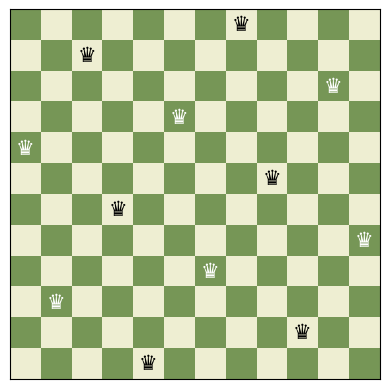

In [19]:
plot_chess_board(
    np.asarray(permutation2board(factoradic2permutation(decimal2factoradic(N1, pairs[idx][0])))),
    fontsize=15
)

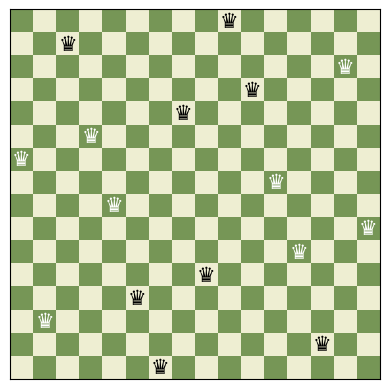

In [20]:
plot_chess_board(
    np.asarray(permutation2board(factoradic2permutation(decimal2factoradic(N2, pairs[idx][1])))),
    fontsize=15
)

In [21]:
pairs[idx][1]

12022229126719

In [22]:
Q2_ref_num = 12022229126719

In [23]:
N3 = 20
solver3 = NQueen_sym90(N3)
solver3.solve_symmetric_nqueen()
Q3s = solver3.solutions
Q3s

{287882893040527638,
 287882899254121878,
 287891349334774350,
 287891355548368590,
 287945667314088678,
 287945673527682918,
 287954123608335390,
 287954129821929630,
 294287383018466436,
 294287700596529756,
 294288690672876036,
 294289008250939356,
 294372378016407174,
 294372695594470494,
 294373685670816774,
 294374003248880094,
 313495811407141020,
 313496128985204340,
 313497119061550620,
 313497436639613940,
 313580806405081758,
 313581123983145078,
 313582114059491358,
 313582431637554678,
 319915685273141004,
 319915691486735244,
 319924141567387716,
 319924147780981956,
 319978459546702044,
 319978465760296284,
 319986915840948756,
 319986922054542996,
 406180346994018912,
 406180359288513552,
 406188803288265624,
 406188815582760264,
 406536034395624672,
 406536046690119312,
 406544490689871384,
 406544502984366024,
 411172610036361386,
 411172626801431066,
 411172697197960106,
 411172713963029786,
 414713792224905456,
 414713808989975136,
 414713879386504176,
 414713896151

In [24]:
# Takes ~ 5 minutes
eps = 1e-2
min_dist = float("inf")
best_fits = []

Q2 = permutation2board(factoradic2permutation(decimal2factoradic(N2, Q2_ref_num)))
for Q3_num in tqdm(Q3s):
    Q3 = permutation2board(factoradic2permutation(decimal2factoradic(N3, Q3_num)))
    D = dist(Q2, Q3)
    if D < min_dist - eps:
        best_fits = [Q3_num]
    elif D < min_dist + eps:
        best_fits.append(Q3_num)
    min_dist = min(D, min_dist)
    
len(best_fits)

  0%|          | 0/480 [00:00<?, ?it/s]

15

In [25]:
best_fits_ = best_fits.copy()
len(best_fits_)

15

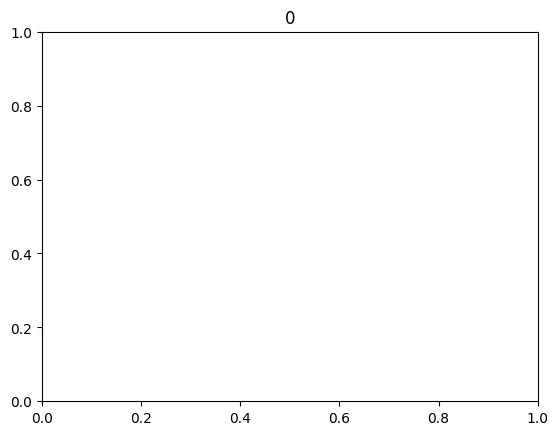

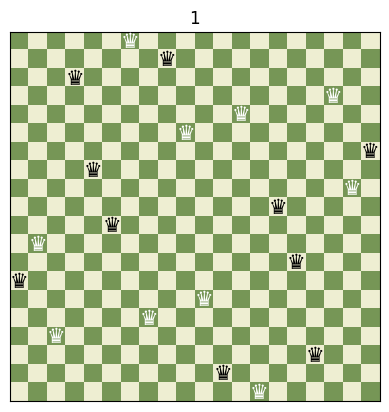

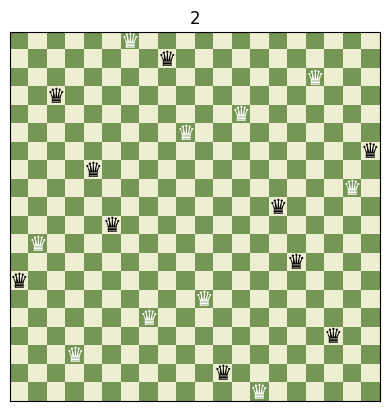

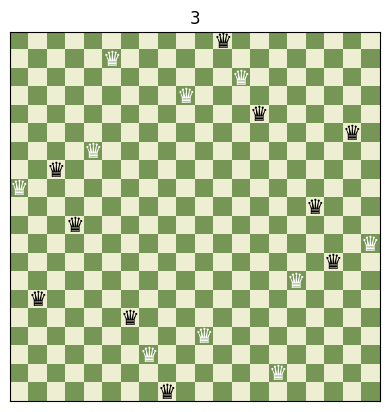

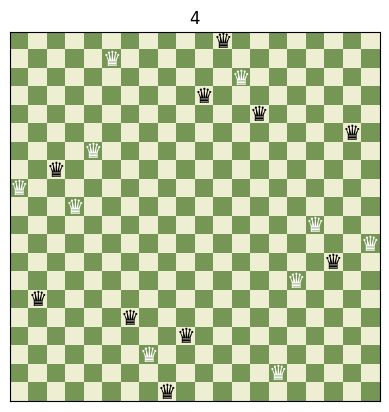

...

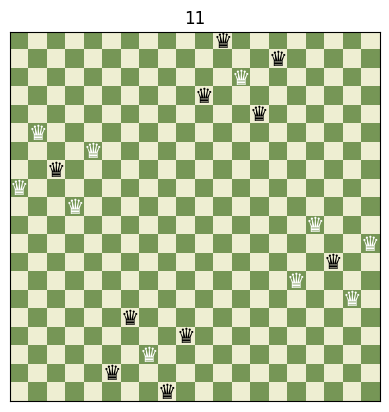

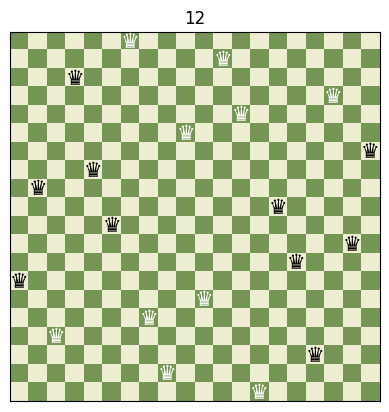

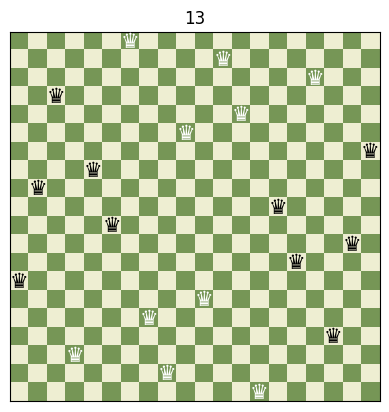

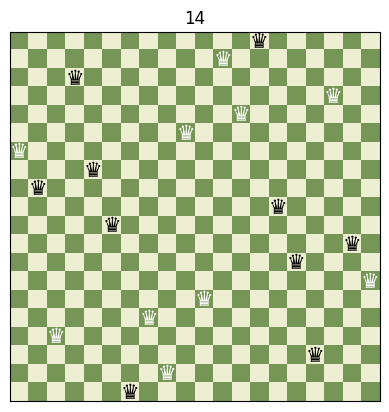

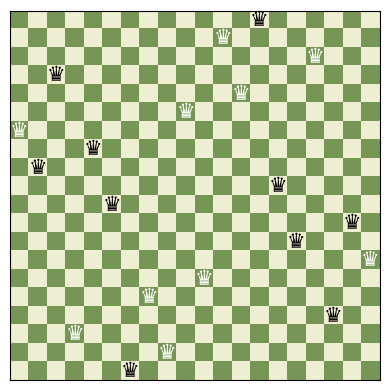

In [26]:
best_fits = best_fits_
for i in range(len(best_fits)):
    plt.title(f"{i}")
    plot_chess_board(
        np.asarray(permutation2board(factoradic2permutation(decimal2factoradic(N3, best_fits[i])))),
        fontsize=15
    )
plt.show()

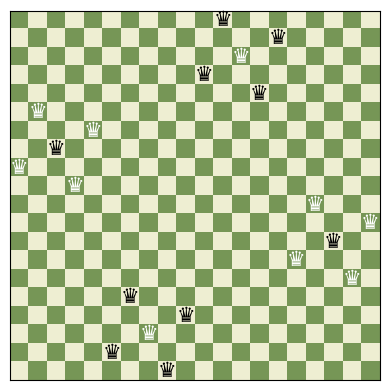

In [27]:
# This is a composition of two such solutions and a perfect only 4 lines solution (all lie *exactly* on the line, no ~)
plot_chess_board(
    np.asarray(permutation2board(factoradic2permutation(decimal2factoradic(N3, 1425461935364121524)))),
    fontsize=15
)

#### $20 \to 24$

In [28]:
Q3_ref_num = 1425461935364121524

In [29]:
N4 = 24
solver4 = NQueen_sym90(N4)
solver4.solve_symmetric_nqueen()
Q4s = solver4.solutions
len(Q4s)

3328

In [30]:
eps = 1e-2
min_dist = float("inf")
best_fits = []

Q3 = permutation2board(factoradic2permutation(decimal2factoradic(N3, Q3_ref_num)))
for Q4_num in tqdm(Q4s):
    Q4 = permutation2board(factoradic2permutation(decimal2factoradic(N4, Q4_num)))
    D = dist(Q3, Q4, N_fine=512) # Adjusted precision for speed 
    if D < min_dist - eps:
        best_fits = [Q4_num]
    elif D < min_dist + eps:
        best_fits.append(Q4_num)
    min_dist = min(D, min_dist)
    
len(best_fits)

  0%|          | 0/3328 [00:00<?, ?it/s]

73

In [31]:
best_fits_ = best_fits.copy()

C:\Users\Hugo\AppData\Local\Temp\ipykernel_17644\2169737698.py:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


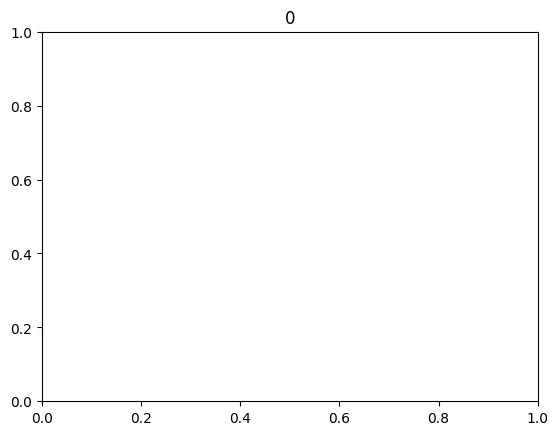

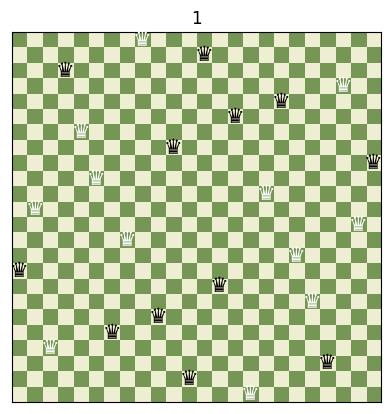

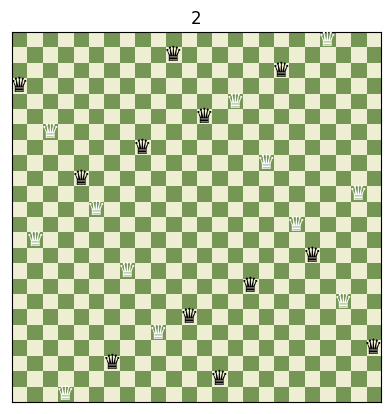

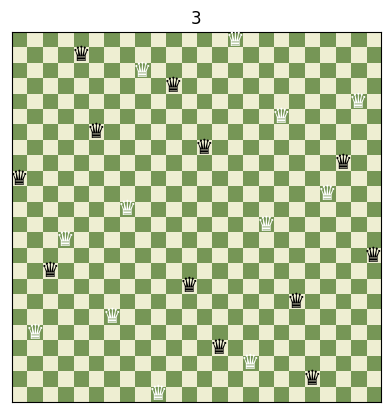

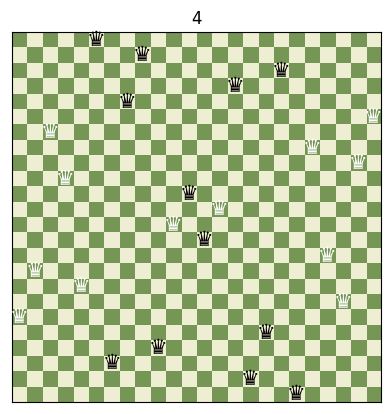

...

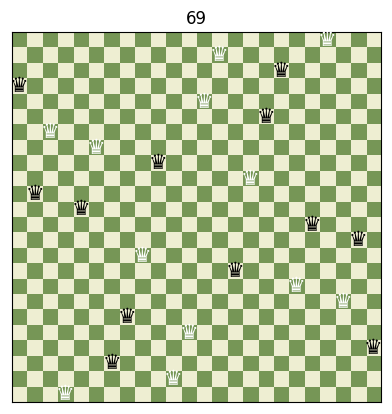

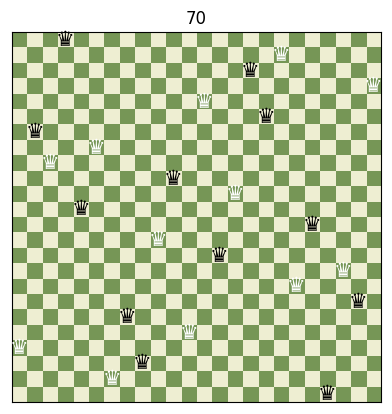

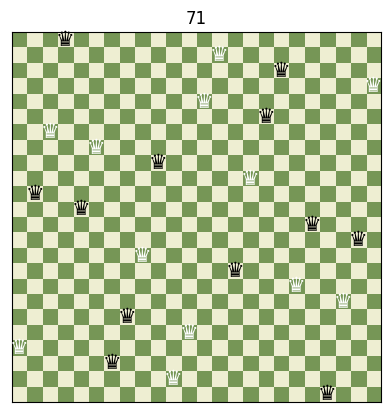

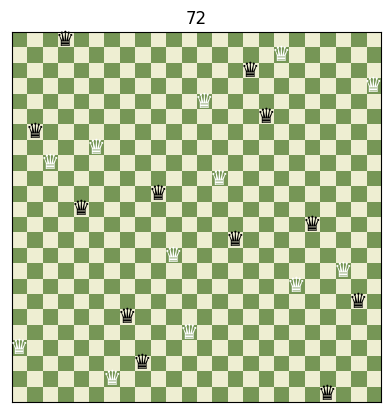

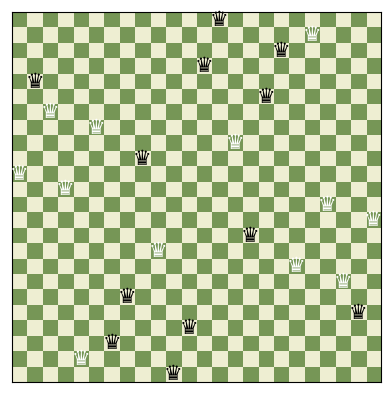

In [32]:
best_fits = best_fits_
for i in range(len(best_fits)):
    plt.title(f"{i}")
    plot_chess_board(
        np.asarray(permutation2board(factoradic2permutation(decimal2factoradic(N4, best_fits[i])))),
        fontsize=15
    )
plt.show()

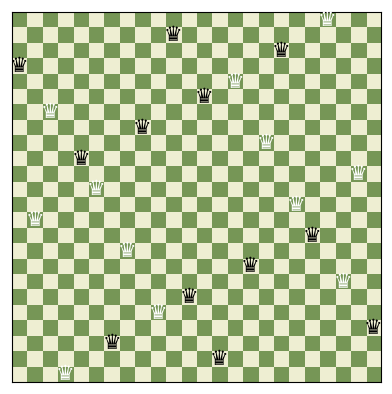

529099321389716195827629

In [33]:
# 4 ~ straight lines
plot_chess_board(
        np.asarray(permutation2board(factoradic2permutation(decimal2factoradic(N4, 529099321389716195827629)))),
        fontsize=15
    )
plt.show()
best_fits[1]

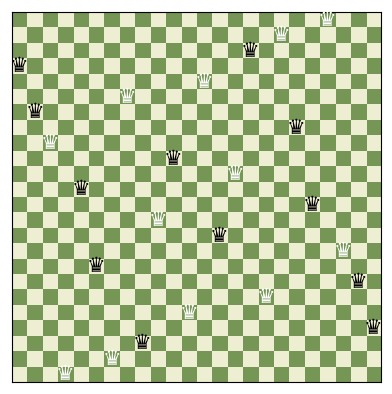

536916088044488415966335

In [34]:
# 4 ~ straight lines + center config
plot_chess_board(
        np.asarray(permutation2board(factoradic2permutation(decimal2factoradic(N4, 536916088044488415966335)))),
        fontsize=15
    )
plt.show()
best_fits[34]

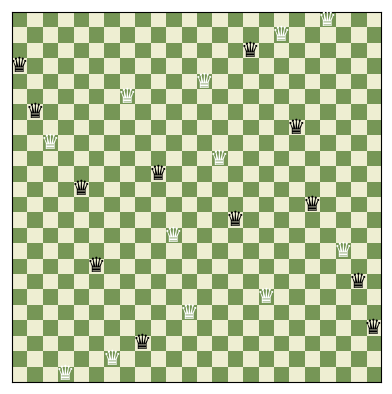

536916088044644098381055

In [35]:
# 4 ~ straight lines + center config
plot_chess_board(
        np.asarray(permutation2board(factoradic2permutation(decimal2factoradic(N4, 536916088044644098381055)))),
        fontsize=15
    )
plt.show()
best_fits[39]

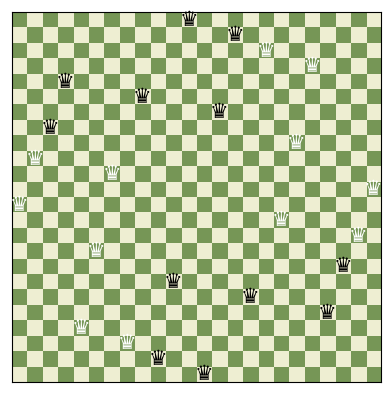

In [36]:
# Throwing star shape is interesting: 299738806576511482774656
plot_chess_board(
        np.asarray(permutation2board(factoradic2permutation(decimal2factoradic(N4, 299738806576511482774656)))),
        fontsize=15
    )
plt.show()

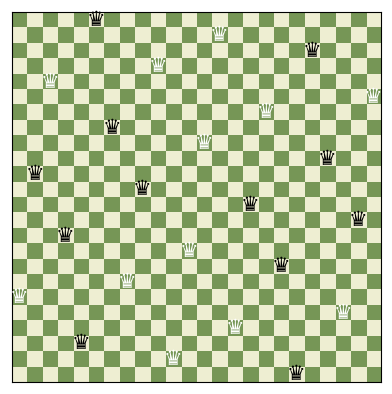

In [37]:
# Uniform / a bunch of parallel lines is interesting: 143636464557124460154108
plot_chess_board(
        np.asarray(permutation2board(factoradic2permutation(decimal2factoradic(N4, 143636464557124460154108)))),
        fontsize=15
    )
plt.show()

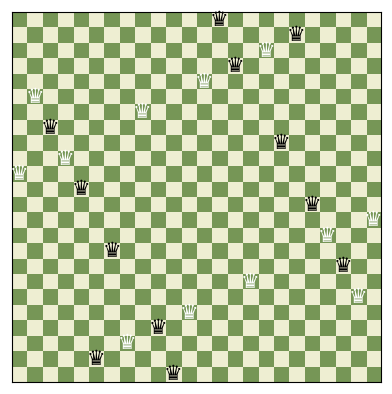

355983690503883603363830

In [38]:
# 4 ~ straight lines
plot_chess_board(
        np.asarray(permutation2board(factoradic2permutation(decimal2factoradic(N4, 355983690503883603363830)))),
        fontsize=15
    )
plt.show()
best_fits[41]

#### $24 \to 28$

In [39]:
Q4_ref_num = 355983690503883603363830

In [40]:
N5 = 28
solver5 = NQueen_sym90(N5)
solver5.solve_symmetric_nqueen()
Q5s = solver5.solutions
len(Q5s)

32896

In [41]:
eps = 1e-2
min_dist = float("inf")
best_fits = []

Q4 = permutation2board(factoradic2permutation(decimal2factoradic(N4, Q4_ref_num)))
for Q5_num in tqdm(Q5s):
    Q5 = permutation2board(factoradic2permutation(decimal2factoradic(N5, Q5_num)))
    D = dist(Q4, Q5, N_fine=512) # Adjusted precision for speed 
    if D < min_dist - eps:
        best_fits = [Q5_num]
    elif D < min_dist + eps:
        best_fits.append(Q5_num)
    min_dist = min(D, min_dist)
    
len(best_fits)

  0%|          | 0/32896 [00:00<?, ?it/s]

213

In [42]:
best_fits_ = best_fits.copy()

C:\Users\Hugo\AppData\Local\Temp\ipykernel_17644\2169737698.py:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


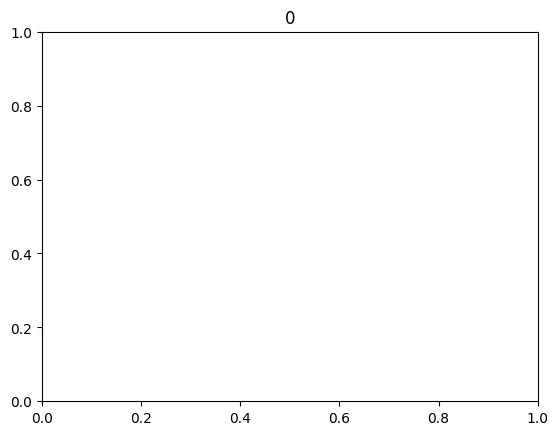

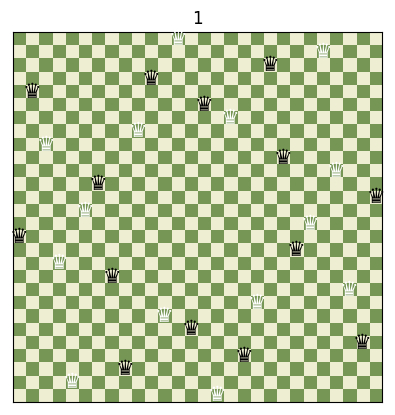

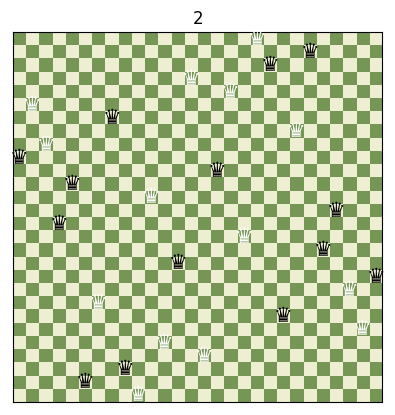

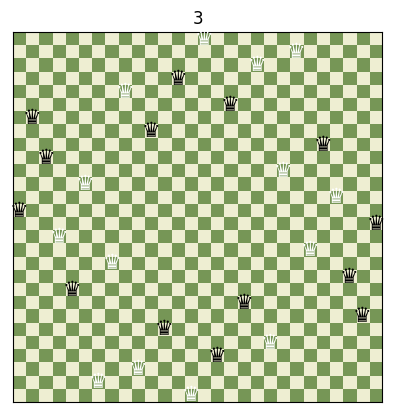

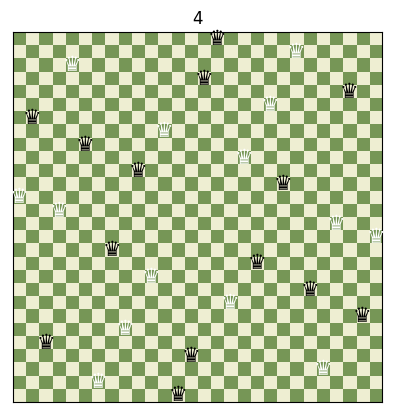

...

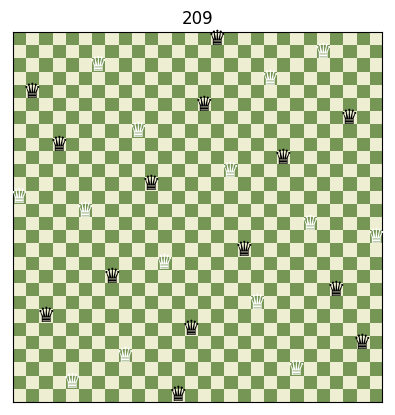

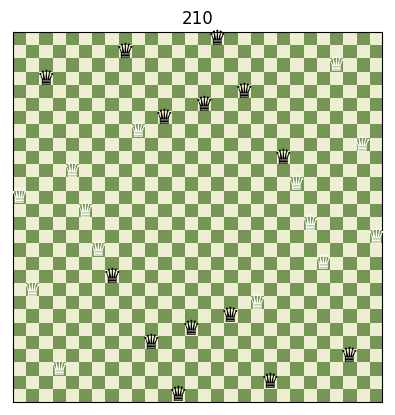

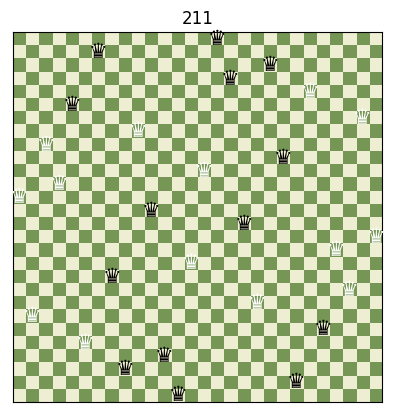

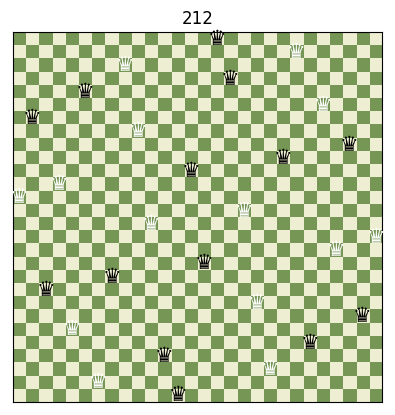

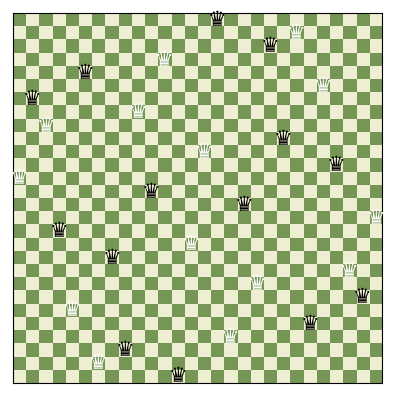

In [43]:
best_fits = best_fits_
for i in range(len(best_fits)):
    plt.title(f"{i}")
    plot_chess_board(
        np.asarray(permutation2board(factoradic2permutation(decimal2factoradic(N5, best_fits[i])))),
        fontsize=15
    )
plt.show()

Interesting idx's: 133,139,147,152,166,202

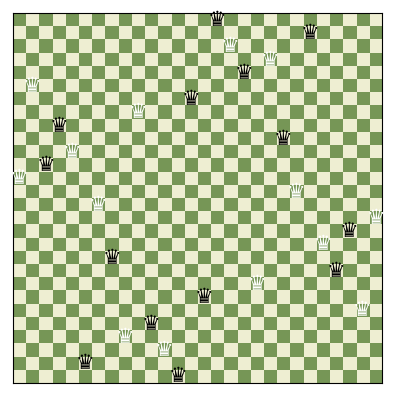

172045767750540615577137818816

In [45]:
# 4 ~ straight lines
plot_chess_board(
        np.asarray(permutation2board(factoradic2permutation(decimal2factoradic(N5, 172045767750540615577137818816)))),
        fontsize=15
    )
plt.show()
best_fits[133]

#### $28 \to 32$

In [46]:
Q5_ref_num = 172045767750540615577137818816

In [47]:
N6 = 32
solver6 = NQueen_sym90(N6)
solver6.solve_symmetric_nqueen()
Q6s = solver6.solutions
len(Q6s)

406784

In [48]:
eps = 1e-2
min_dist = float("inf")
best_fits = []

Q5 = permutation2board(factoradic2permutation(decimal2factoradic(N5, Q5_ref_num)))
for Q6_num in tqdm(Q6s):
    Q6 = permutation2board(factoradic2permutation(decimal2factoradic(N6, Q6_num)))
    D = dist(Q5, Q6, N_fine=256) # Adjusted precision for speed 
    if D < min_dist - eps:
        best_fits = [Q6_num]
    elif D < min_dist + eps:
        best_fits.append(Q6_num)
    min_dist = min(D, min_dist)
    
len(best_fits)

  0%|          | 0/406784 [00:00<?, ?it/s]

1455

In [49]:
best_fits_ = best_fits.copy()

C:\Users\Hugo\AppData\Local\Temp\ipykernel_17644\2169737698.py:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


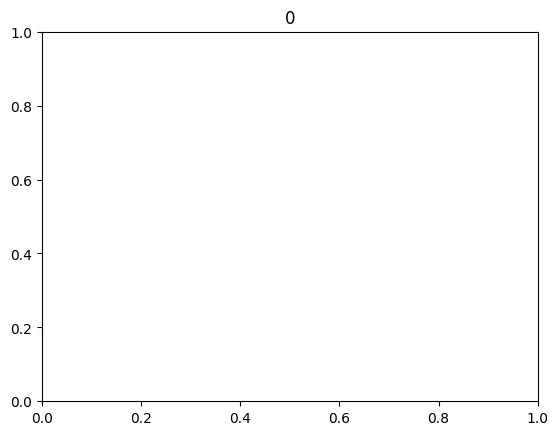

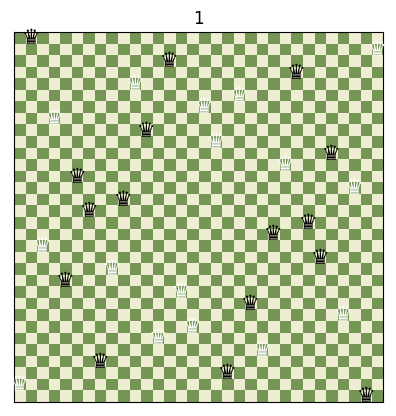

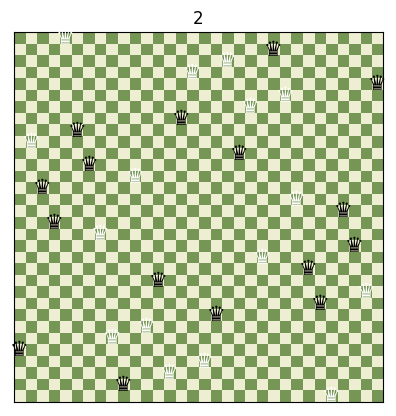

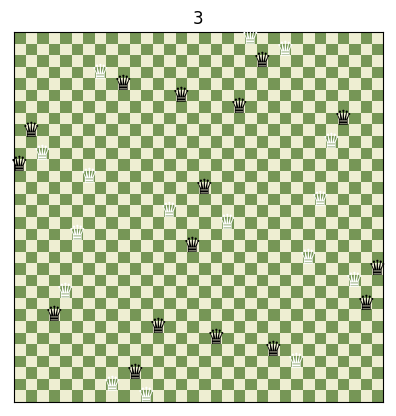

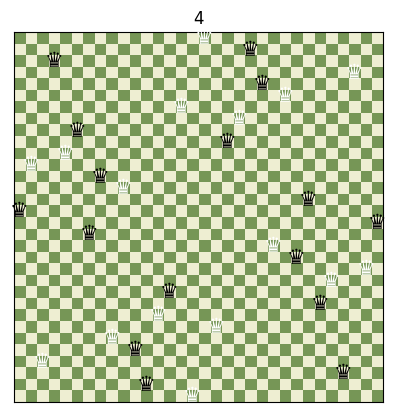

...

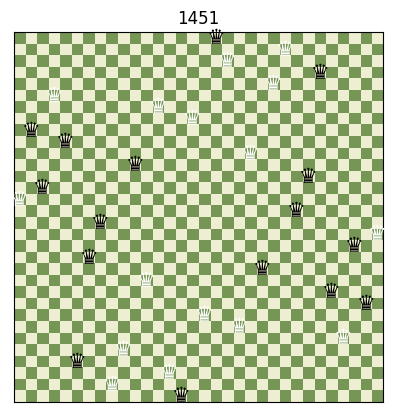

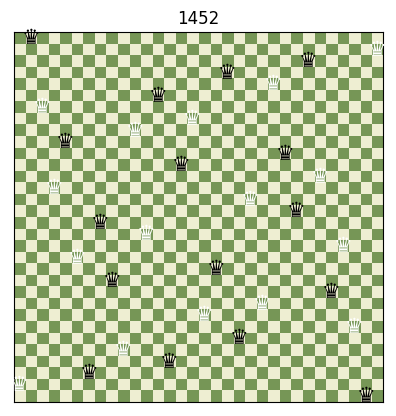

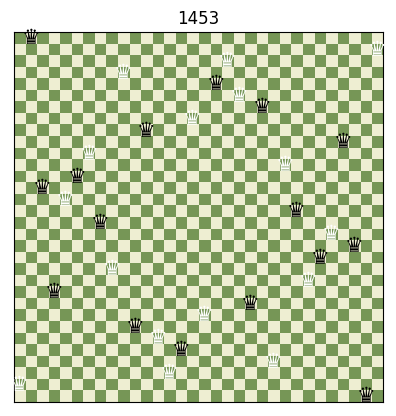

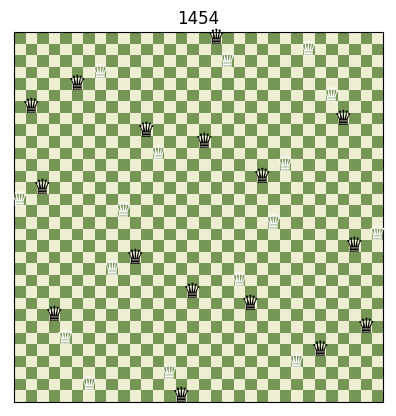

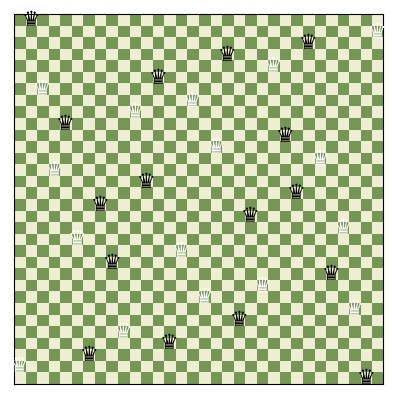

In [50]:
best_fits = best_fits_
for i in range(len(best_fits)):
    plt.title(f"{i}")
    plot_chess_board(
        np.asarray(permutation2board(factoradic2permutation(decimal2factoradic(N6, best_fits[i])))),
        fontsize=15
    )
plt.show()

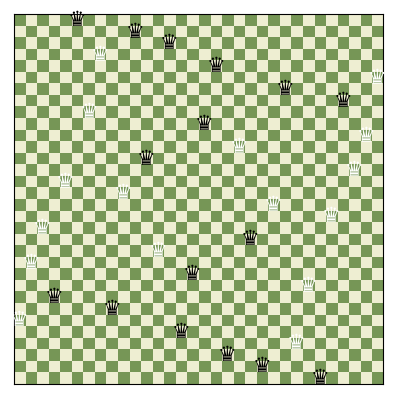

In [52]:
plot_chess_board(
    np.asarray(permutation2board(factoradic2permutation(decimal2factoradic(N6, 43600710055073358134042307243486732)))),
    fontsize=15
)

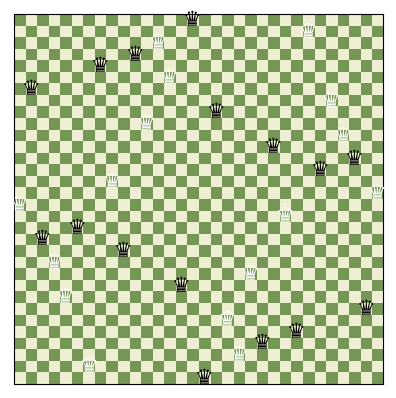

In [54]:
plot_chess_board(
    np.asarray(permutation2board(factoradic2permutation(decimal2factoradic(N6, 129817878758747683568143442377705798)))),
    fontsize=15
)

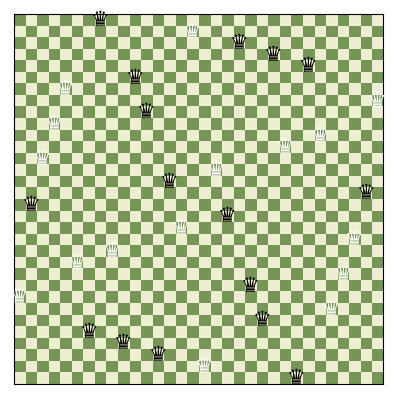

In [56]:
plot_chess_board(
    np.asarray(permutation2board(factoradic2permutation(decimal2factoradic(N6, 61429745822085636267113832986397120)))),
    fontsize=15
)

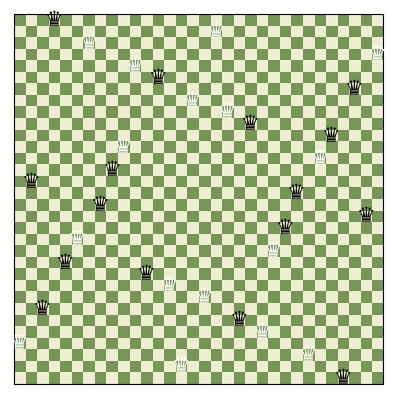

In [59]:
plot_chess_board(
    np.asarray(permutation2board(factoradic2permutation(decimal2factoradic(N6, 28965398523145204910059891072585730)))),
    fontsize=15
)

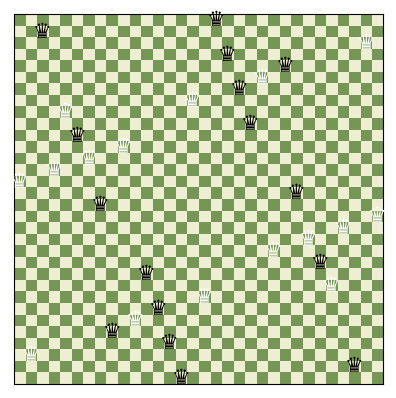

In [61]:
plot_chess_board(
    np.asarray(permutation2board(factoradic2permutation(decimal2factoradic(N6, 140571435683581976367204204716949151)))),
    fontsize=15
)

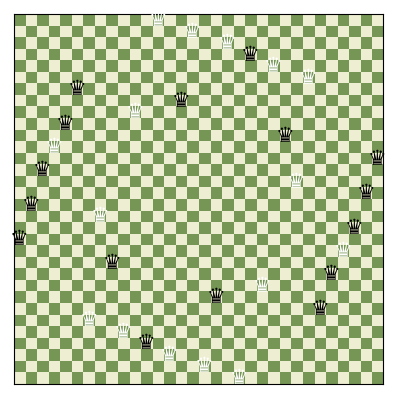

In [63]:
plot_chess_board(
    np.asarray(permutation2board(factoradic2permutation(decimal2factoradic(N6, 102534459331982633154545441466016080)))),
    fontsize=15
)

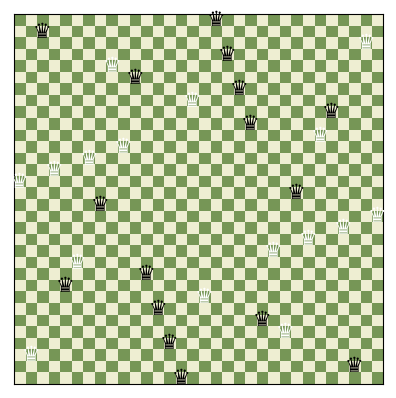

In [65]:
plot_chess_board(
    np.asarray(permutation2board(factoradic2permutation(decimal2factoradic(N6, 140571290063540322096643821581376199)))),
    fontsize=15
)

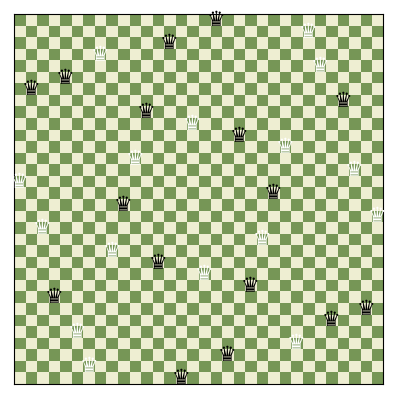

In [67]:
plot_chess_board(
    np.asarray(permutation2board(factoradic2permutation(decimal2factoradic(N6, 146271644077901258301175201454714062)))),
    fontsize=15
)

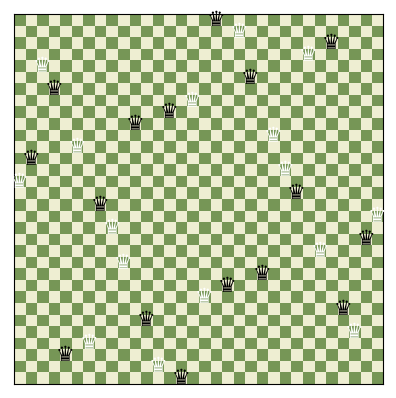

In [69]:
plot_chess_board(
    np.asarray(permutation2board(factoradic2permutation(decimal2factoradic(N6, 144790893752489765183191431784769622)))),
    fontsize=15
)

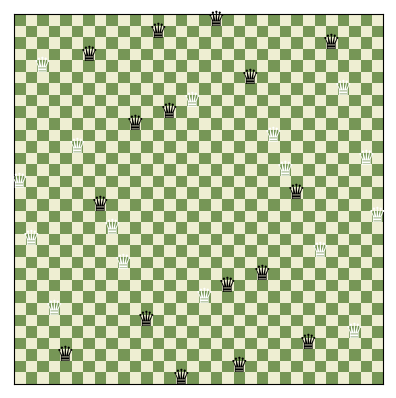

In [71]:
plot_chess_board(
    np.asarray(permutation2board(factoradic2permutation(decimal2factoradic(N6, 143194193398044663524580334832406955)))),
    fontsize=15
)

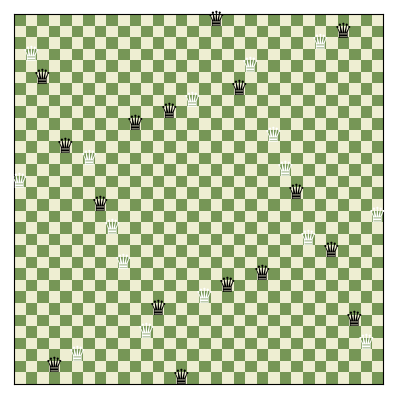

In [75]:
plot_chess_board(
    np.asarray(permutation2board(factoradic2permutation(decimal2factoradic(N6, 147171629933622794090953572940787588)))),
    fontsize=15
)

In [74]:
best_fits[1433]

147171629933622794090953572940787588

From the results above, there are a bunch of ways I can go about proving it

1. Using 4 lines to cover all the queens and showing the lines invariant on N, after normalizing to $[-1/2, 1/2]^2$
2. Composition, there is a very interesting composition pattern at play
3. Uniformly distributed

### 4 Line cover

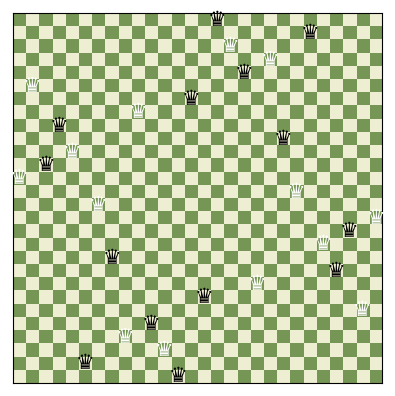

### Composition
From the results above, these results seem quite interesting:

Q(20):
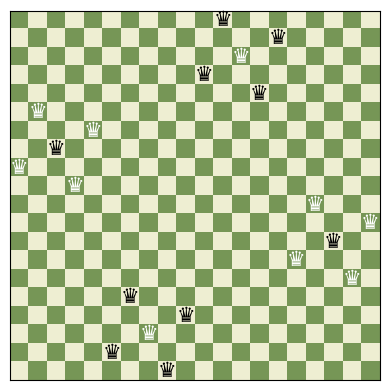

Bonus: Hesteløsning komponer med 5x5 løsning

Alle løsninger kan udvides med en (5x5)

$Q(5n) \geq Q(n)$

### Line method
I could try to find a line that goes through $\frac{1}{4}n + O(1)$ solutions whose symmetries cover all queens